<a href="https://colab.research.google.com/github/AronPerez/CS_4263/blob/main/Full_cycle.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Train data time

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install zarr
!pip install l5kit
!pip install colorama
!pip install -U PyYAML

     |████████████████████████████████| 143kB 6.8MB/s 
     |████████████████████████████████| 5.8MB 7.8MB/s 
  Created wheel for asciitree: filename=asciitree-0.3.3-cp37-none-any.whl size=5037 sha256=11db95ce1a172a72d9618f37c24e2d7253df321446336320a277b2aab6e3ea25
  Stored in directory: /root/.cache/pip/wheels/1d/d9/58/9808b306744df0208fccc640d3d9952a5bc7468502d42897d5
Successfully built asciitree
     |████████████████████████████████| 92kB 4.3MB/s 
     |████████████████████████████████| 71kB 8.6MB/s 
     |████████████████████████████████| 43.6MB 63kB/s 
     |████████████████████████████████| 40kB 5.9MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for pymap3d: filename=pymap3d-2.6.0-cp37-none-any.whl size=50119 sha256=fdcf4ef0a612752df2afa8cdc4e7bda6a06ca4d47d92fd801f518036034ca865
  Stored in directory: /root/.cache/pip/wheels/6c/47/77/85ddae5d29443cda2ce5c9f8079e1d84052c53be6c44fe

In [ ]:
import os, gc
import zarr
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import torch
import l5kit
import psutil
import os
import random
import time
import pprint
from tqdm import tqdm
import tqdm.notebook as tq
from typing import Dict
from collections import Counter
from prettytable import PrettyTable
import warnings
warnings.filterwarnings("ignore")
from matplotlib import animation, rc
from IPython.display import HTML, display

rc('animation', html='jshtml')
import matplotlib.patches as mpatches


#level5 toolkit
from l5kit.data import labels
from l5kit.dataset import EgoDataset, AgentDataset
from l5kit.data import ChunkedDataset, LocalDataManager

# level5 toolkit 
from l5kit.configs import load_config_data
from l5kit.geometry import transform_points
from l5kit.rasterization import build_rasterizer
from l5kit.visualization import draw_trajectory, draw_reference_trajectory, TARGET_POINTS_COLOR
from l5kit.evaluation import write_pred_csv, compute_metrics_csv, read_gt_csv, create_chopped_dataset
from l5kit.evaluation import *
from l5kit.kinematic import AckermanPerturbation
from l5kit.random import GaussianRandomGenerator

# visualization
from matplotlib import animation
from colorama import Fore, Back, Style

# deep learning
from torch import nn, optim
from torch.utils.data import DataLoader
from torchvision.models.resnet import resnet18, resnet50, resnet34

In [ ]:
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    
set_seed(42)

# Memory usage checker

# Config details
#### model_architecture: Able to put 'resnet18', 'resnet34' or 'resnet50'. For the pretrained model we use resnet18 so we need to use 'resnet18' in the config.
#### weight_path: Path to the pretrained model. If you don't have a pretrained model and want to train from scratch, put weight_path = False.
#### model_name: The name of the model that will be saved as output, this is only when train= True.
#### train: True if you want to continue to train the model. Unfortunately due to Kaggle memory constraint if train=True then you should put predict = False.
#### predict: True if you want to predict and submit to Kaggle. Unfortunately due to Kaggle memory constraint if you want to predict then you need to put train = False.
#### lr: Learning rate of the model, feel free to change as you see fit. In the future I also plan to implement learning rate decay.
#### raster_size: Specify the size of the image, the default is [224,224]. Increase raster_size can improve the score. However the training time will be significantly longer.
#### batch_size: Number of inputs for one forward pass, again one of the parameters to tune.
#### max_num_steps: The number of iterations to train, i.e. number of epochs.
#### checkpoint_every_n_steps: The model will be saved at every n steps, again change this number as to how you want to keep track of the model.


In [ ]:
# set env variable for data
DIR_INPUT = "/content/drive/MyDrive/lyft-motion-prediction-autonomous-vehicles/"
cfg = load_config_data("./config.yaml")
os.environ["L5KIT_DATA_FOLDER"] = DIR_INPUT
dm = LocalDataManager(None)

# ===== INIT TRAIN DATASET=====

In [ ]:
train_cfg = cfg["train_data_loader"]
rasterizer = build_rasterizer(cfg, dm)

train_zarr = ChunkedDataset(dm.require(train_cfg["key"])).open()

train_dataset_2 = AgentDataset(cfg, train_zarr, rasterizer)
train_dataloader_2 = DataLoader(train_dataset_2, shuffle=train_cfg["shuffle"], batch_size=train_cfg["batch_size"],
                                num_workers=train_cfg["num_workers"])

print("==================================TRAIN DATA==================================")
print(train_dataset_2)

==================================TRAIN DATA==================================
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16265    |  4039527   | 320124624  |    38735988   |      112.19     |        248.36        |        79.25         |        24.83         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


# ======INIT TEST DATASET====== 

In [ ]:
test_cfg = cfg["test_data_loader"]
rasterizer = build_rasterizer(cfg, dm)
test_zarr = ChunkedDataset(dm.require(test_cfg["key"])).open()
test_mask = np.load(f"{DIR_INPUT}/scenes/mask.npz")["arr_0"]
test_dataset = AgentDataset(cfg, test_zarr, rasterizer, agents_mask=test_mask) #Artifically applies agents
test_dataloader = DataLoader(test_dataset,shuffle=test_cfg["shuffle"],batch_size=test_cfg["batch_size"],
                             num_workers=test_cfg["num_workers"])
print("==================================TEST DATA==================================")
print(test_dataset)

==================================TEST DATA==================================
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   11314    |  1131400   |  88594921  |    7854144    |      31.43      |        100.00        |        78.31         |        10.00         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


# ====== INT VAL DATASET ====== 

In [ ]:
val_cfg = cfg["val_data_loader"]
rasterizer = build_rasterizer(cfg, dm)
val_zarr = ChunkedDataset(dm.require(val_cfg["key"])).open()
val_dataset = AgentDataset(cfg, val_zarr, rasterizer)
val_dataloader = DataLoader(val_dataset,shuffle=val_cfg["shuffle"],batch_size=val_cfg["batch_size"],num_workers=val_cfg["num_workers"])
print("==================================VAL DATA==================================")
print(val_dataset)

==================================VAL DATA==================================
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   16220    |  4030296   | 312617887  |    29277930   |      111.97     |        248.48        |        77.57         |        24.85         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


# Loss function

In [ ]:
from torch import Tensor
def pytorch_neg_multi_log_likelihood_batch(
    gt: Tensor, pred: Tensor, confidences: Tensor, avails: Tensor
) -> Tensor:
    """
    Compute a negative log-likelihood for the multi-modal scenario.
    log-sum-exp trick is used here to avoid underflow and overflow, For more information about it see:
    https://en.wikipedia.org/wiki/LogSumExp#log-sum-exp_trick_for_log-domain_calculations
    https://timvieira.github.io/blog/post/2014/02/11/exp-normalize-trick/
    https://leimao.github.io/blog/LogSumExp/
    Args:
        gt (Tensor): array of shape (bs)x(time)x(2D coords)
        pred (Tensor): array of shape (bs)x(modes)x(time)x(2D coords)
        confidences (Tensor): array of shape (bs)x(modes) with a confidence for each mode in each sample
        avails (Tensor): array of shape (bs)x(time) with the availability for each gt timestep
    Returns:
        Tensor: negative log-likelihood for this example, a single float number
    """
    assert len(pred.shape) == 4, f"expected 3D (MxTxC) array for pred, got {pred.shape}"
    batch_size, num_modes, future_len, num_coords = pred.shape

    assert gt.shape == (batch_size, future_len, num_coords), f"expected 2D (Time x Coords) array for gt, got {gt.shape}"
    assert confidences.shape == (batch_size, num_modes), f"expected 1D (Modes) array for gt, got {confidences.shape}"
    assert torch.allclose(torch.sum(confidences, dim=1), confidences.new_ones((batch_size,))), "confidences should sum to 1"
    assert avails.shape == (batch_size, future_len), f"expected 1D (Time) array for gt, got {avails.shape}"
    # assert all data are valid
    assert torch.isfinite(pred).all(), "invalid value found in pred"
    assert torch.isfinite(gt).all(), "invalid value found in gt"
    assert torch.isfinite(confidences).all(), "invalid value found in confidences"
    assert torch.isfinite(avails).all(), "invalid value found in avails"

    # convert to (batch_size, num_modes, future_len, num_coords)
    gt = torch.unsqueeze(gt, 1)  # add modes
    avails = avails[:, None, :, None]  # add modes and cords

    # error (batch_size, num_modes, future_len)
    error = torch.sum(((gt - pred) * avails) ** 2, dim=-1)  # reduce coords and use availability

    with np.errstate(divide="ignore"):  # when confidence is 0 log goes to -inf, but we're fine with it
        # error (batch_size, num_modes)
        error = torch.log(confidences) - 0.5 * torch.sum(error, dim=-1)  # reduce time

    # use max aggregator on modes for numerical stability
    # error (batch_size, num_modes)
    max_value, _ = error.max(dim=1, keepdim=True)  # error are negative at this point, so max() gives the minimum one
    error = -torch.log(torch.sum(torch.exp(error - max_value), dim=-1, keepdim=True)) - max_value  # reduce modes
    # print("error", error)
    return torch.mean(error)


def pytorch_neg_multi_log_likelihood_single(
    gt: Tensor, pred: Tensor, avails: Tensor
) -> Tensor:
    """

    Args:
        gt (Tensor): array of shape (bs)x(time)x(2D coords)
        pred (Tensor): array of shape (bs)x(time)x(2D coords)
        avails (Tensor): array of shape (bs)x(time) with the availability for each gt timestep
    Returns:
        Tensor: negative log-likelihood for this example, a single float number
    """
    # pred (bs)x(time)x(2D coords) --> (bs)x(mode=1)x(time)x(2D coords)
    # create confidence (bs)x(mode=1)
    batch_size, future_len, num_coords = pred.shape
    confidences = pred.new_ones((batch_size, 1))
    return pytorch_neg_multi_log_likelihood_batch(gt, pred.unsqueeze(1), confidences, avails)

# Model

In [ ]:
class Model(nn.Module):

    def __init__(self, cfg: Dict, num_modes=3):
        super().__init__()
    
        
        architecture = cfg["model_params"]["model_architecture"]
        self.backbone = resnet50(pretrained=True, progress=True)

        num_history_channels = (cfg["model_params"]["history_num_frames"] + 1) * 2
        num_in_channels = 3 + num_history_channels

        self.backbone.conv1 = nn.Sequential(
            nn.Conv2d(
                num_in_channels, 
                self.backbone.conv1.out_channels, 
                self.backbone.conv1.kernel_size,
                stride=self.backbone.conv1.stride,
                padding=self.backbone.conv1.padding,
                bias=False,
            ),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=self.backbone.conv1.kernel_size),
        )

        # This is 512 for resnet18 and resnet34;
        # And it is 2048 for the other resnets
        
        if architecture == "resnet50":
            backbone_out_features = 2048
        else:
            backbone_out_features = 512

        # X, Y coords for the future positions (output shape: batch_sizex50x2)
        self.future_len = cfg["model_params"]["future_num_frames"]
        num_targets = 2 * self.future_len

        # You can add more layers here.
        self.head = nn.Sequential(
            # nn.Dropout(0.2),
            nn.Linear(in_features=backbone_out_features, out_features=4096),
        )

        self.num_preds = num_targets * num_modes
        self.num_modes = num_modes

        self.logit = nn.Linear(4096, out_features=self.num_preds + num_modes)

    def forward(self, x):
        x = self.backbone.conv1(x)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)

        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)

        x = self.backbone.avgpool(x)
        x = torch.flatten(x, 1)

        x = self.head(x)
        x = self.logit(x)

        # pred (batch_size)x(modes)x(time)x(2D coords)
        # confidences (batch_size)x(modes)
        bs, _ = x.shape
        pred, confidences = torch.split(x, self.num_preds, dim=1)
        pred = pred.view(bs, self.num_modes, self.future_len, 2)
        assert confidences.shape == (bs, self.num_modes)
        confidences = torch.softmax(confidences, dim=1)
        return pred, confidences

In [ ]:
def forward(data, model, device, criterion = pytorch_neg_multi_log_likelihood_batch):
    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].to(device)
    targets = data["target_positions"].to(device)
    # Forward pass
    preds, confidences = model(inputs)
    loss = criterion(targets, preds, confidences, target_availabilities)
    return loss, preds, confidences

# ==== INIT MODEL ==== 

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = Model(cfg)

#load weight if there is a pretrained model
weight_path = cfg["model_params"]["weight_path"]
if weight_path != "None": #https://stackoverflow.com/questions/56369030/runtimeerror-attempting-to-deserialize-object-on-a-cuda-device
    model.load_state_dict(torch.load(weight_path, map_location=torch.device('cpu')))

model.to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)
print(f'device {device}')

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth



device cuda:0


### We aren't going to use our pretrained model, we're going to trin out own, so let's begin

In [ ]:
tr_it = iter()

## progress bar for command line
#progress = tqdm(range(cfg["train_params"]["max_num_steps"]))

## progress bar for google colab
progress = tq.tqdm(range(cfg["train_params"]["max_num_steps"]))


torch.set_grad_enabled(False)

#############################################################
# using this to prevent error not sure what this list or array should be
losses_train = []


for _ in progress:    
    try:
        data = next(tr_it)
    except StopIteration:
        tr_it = iter(train_dataloader_2)
        data = next(tr_it)

    model.train()
    torch.set_grad_enabled(True)
    loss, *_ = forward(data, model, device)

    # Backward pass
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    losses_train.append(loss.item())
    #progress.set_description(f"loss: {loss.item()} loss(avg): {np.mean(losses_train)}")
    
#     _, preds, confidences = forward(data, model, device)
    
#     try:
#         data = next(tr_it)
#     except StopIteration:
#         tr_it = iter(train_dataloader_2)
#         data = next(tr_it)
#     # Forward pass
#     data = {k: v.to(device) for k, v in data.items()}
#     result = model(data)
#     loss = result["loss"]
#     # Backward pass
#     optimizer.zero_grad()
#     loss.backward()
#     optimizer.step()

#     losses_train.append(loss.item())
#     progress_bar.set_description(f"loss: {loss.item()} loss(avg): {np.mean(losses_train)}")

# Eval loop

In [ ]:
if cfg["model_params"]["predict"]:
    
    model.eval()
    torch.set_grad_enabled(False)

    # store information for evaluation
    future_coords_offsets_pd = []
    timestamps = []
    confidences_list = []
    agent_ids = []

    progress_bar = tqdm(test_dataloader)
    
    for data in progress_bar:
        
        _, preds, confidences = forward(data, model, device)
    
        #fix for the new environment
        preds = preds.cpu().numpy()
        world_from_agents = data["world_from_agent"].numpy()
        centroids = data["centroid"].numpy()
        coords_offset = []
        
        # convert into world coordinates and compute offsets
        for idx in range(len(preds)):
            for mode in range(3):
                preds[idx, mode, :, :] = transform_points(preds[idx, mode, :, :], world_from_agents[idx]) - centroids[idx][:2]
    
        future_coords_offsets_pd.append(preds.copy())
        confidences_list.append(confidences.cpu().numpy().copy())
        timestamps.append(data["timestamp"].numpy().copy())
        agent_ids.append(data["track_id"].numpy().copy()) 

100%|██████████| 2223/2223 [1:05:03<00:00,  1.76s/it]


### Now that we've successfully made predictions based on our model, we'll put them into our CSV
From here, we can parse and make interpretations on the data 

In [ ]:
pred_path = 'submission_r3.csv'
write_pred_csv(pred_path,
           timestamps=np.concatenate(timestamps),
           track_ids=np.concatenate(agent_ids),
           coords=np.concatenate(future_coords_offsets_pd),
           confs = np.concatenate(confidences_list)
          )

### Testing the map type attribute of CFG

In [ ]:
print(cfg['raster_params']['map_type'])
cfg['raster_params']['map_type'] = 'py_satellite'
print(cfg['raster_params']['map_type'])

py_semantic
py_satellite


### Loading rasterizers

In [ ]:
# Semantic view
cfg['raster_params']['map_type'] = 'py_semantic'
semantic_rasterizer = build_rasterizer(cfg, dm)

# Satellite view
cfg['raster_params']['map_type'] = 'py_satellite'
satellite_rasterizer = build_rasterizer(cfg, dm)

# Load predictions

In [ ]:
df_sub = pd.read_csv('./submission_r3.csv')
df_sub = df_sub.set_index(['timestamp', 'track_id'])

In [ ]:
display(df_sub)

conf_0    conf_1    conf_2  coord_x00  \
timestamp           track_id                                            
1578606007801600134 2         0.502480  0.205125  0.292395   -0.11273   
1578606032802467516 4         0.380652  0.358710  0.260638   -0.63477   
                    5         0.542430  0.093180  0.364390    0.12414   
                    81        0.213895  0.720917  0.065187   -0.25885   
                    130       0.035118  0.953250  0.011632    0.01142   
...                                ...       ...       ...        ...   
1583863581802681726 253       0.394328  0.332868  0.272804    0.41381   
1583863606802928836 1         0.393627  0.380866  0.225508   -0.12056   
                    6         0.449566  0.303890  0.246544   -0.11545   
                    213       0.349951  0.426899  0.223151   -0.09739   
                    250       0.026675  0.961641  0.011684    0.00730   

                              coord_y00  coord_x01  coord_y01  coord_x02  \
timestamp           track_id                                               
1578606007801600134 2           0.22052   -0.22827    0.47644   -0.33984   
1578606032802467516 4          -0.97205   -1.21299   -1.90659   -1.71423   
                    5           0.20155    0.25162    0.38692    0.32335   
                    81         -0.41525   -0.50425   -0.77621   -0.67320   
                    130        -0.00426    0.02232   -0.01539    0.04585   
...                                 ...        ...        ...        ...   
1583863581802681726 253         0.56903    0.86008    1.13860    1.22542   
1583863606802928836 1          -0.66451   -0.23772   -1.31072   -0.35416   
                    6          -0.24222   -0.24895   -0.51530   -0.34641   
                    213         0.09291   -0.20722    0.21068   -0.30974   
                    250         0.00231    0.01193    0.02457    0.00738   

                              coord_y02  coord_x03  ...  coord_x245  \
timestamp           track_id                        ...               
1578606007801600134 2           0.70938   -0.43328  ...    -3.77350   
1578606032802467516 4          -2.77318   -2.30782  ...   -26.60185   
                    5           0.48188    0.40778  ...    10.76700   
                    81         -1.08616   -0.87364  ...   -14.57502   
                    130        -0.01270    0.07871  ...     7.54188   
...                                 ...        ...  ...         ...   
1583863581802681726 253         1.64566    1.65775  ...    25.76309   
1583863606802928836 1          -1.84177   -0.50479  ...    -8.32895   
                    6          -0.76212   -0.47210  ...    -9.05620   
                    213         0.29671   -0.37174  ...    -1.60544   
                    250         0.00291    0.00285  ...     4.25917   

                              coord_y245  coord_x246  coord_y246  coord_x247  \
timestamp           track_id                                                   
1578606007801600134 2            9.78204    -3.82382     9.98727    -3.82410   
1578606032802467516 4          -52.09507   -27.16204   -53.32994   -27.69998   
                    5           16.50119    11.21318    17.16005    11.64454   
                    81         -20.05598   -15.00511   -20.66341   -15.39089   
                    130         -4.43858     7.81336    -4.62239     8.11577   
...                                  ...         ...         ...         ...   
1583863581802681726 253         26.27295    26.44862    26.82519    27.10458   
1583863606802928836 1          -24.28993    -8.52438   -24.70271    -8.63008   
                    6          -18.69624    -9.27567   -19.12498    -9.51517   
                    213         18.46396    -1.43845    19.15160    -1.23396   
                    250         11.79742     4.41907    12.30276     4.55520   

                              coord_y247  coord_x248  coord_y248  coord_x249  \
timestamp           track_id                    

In [ ]:
def row_to_confs(row):
    return [row[f'conf_{i}'] for i in range(3)]
def row_to_coords(row):
    return row[3:].values.reshape(3, 50, 2)

In [ ]:
dm = LocalDataManager()
zarr_dataset = ChunkedDataset(dm.require(cfg['test_data_loader']['key'])).open()
print(zarr_dataset)

+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   11314    |  1131400   |  88594921  |    7854144    |      31.43      |        100.00        |        78.31         |        10.00         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [ ]:
semantic_dataset = EgoDataset(cfg, zarr_dataset, semantic_rasterizer)
satellite_dataset = EgoDataset(cfg, zarr_dataset, satellite_rasterizer)
test_mask = np.load(f"{DIR_INPUT}/scenes/mask.npz")["arr_0"]
agent_semantic_dataset = AgentDataset(cfg, zarr_dataset, semantic_rasterizer, agents_mask=test_mask)
agent_satellite_dataset = AgentDataset(cfg, zarr_dataset, satellite_rasterizer, agents_mask=test_mask)

In [ ]:
# here I use matplotlib default colors
cmap = plt.get_cmap("tab10")
matplotlib_colors_in_rgb_int = [
    [int(255 * x) for x in cmap(i)[:3]] for i in range(10)
]

# Visualizations

In [ ]:
raster_params = cfg['raster_params']
raster_from_agent = np.array([
    [2., 0.,  56.],
    [0., 2., 112.],
    [0., 0.,   1.],
]) if (
    raster_params['raster_size'] == [224, 224] and
    raster_params['pixel_size'] == [0.5, 0.5] and
    raster_params['ego_center'] == [0.25, 0.5]
) else None
    
def generate_image_trajectory(dataset, index):
    data = dataset[index]
    im = data['image'].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    rfg = raster_from_agent if raster_from_agent is not None else data['raster_from_agent']
    target_positions_pixels = transform_points(data['target_positions'], rfg)
    draw_trajectory(im, target_positions_pixels, yaws=data['target_yaws'], rgb_color=TARGET_POINTS_COLOR)
    return im

def plot_trajectory(dataset, indices, width=12, height=4, n_cols=3, title=''):
    if not isinstance(indices, (list, np.ndarray)):
        indices = [indices]
    n_rows = len(indices) // n_cols + len(indices) % n_cols
    plt.figure(figsize=(width, height*n_rows))
    for k, index in enumerate(indices):
        plt.subplot(n_rows, n_cols, 1+k).set_title(str(index))
        im = generate_image_trajectory(dataset, index)
        plt.imshow(im, origin='lower')
    if title:
        plt.suptitle(title)
    plt.show()

def generate_image_predicted_trajectory(dataset, df_sub, index):
    data = dataset[index]
    im = data['image'].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    row = df_sub.loc[(data['timestamp'], data['track_id'])]
    # note submission coordinate system = world - centroid
    predicted_target_positions_in_sub = row_to_coords(row)
    predicted_target_positions_in_world = predicted_target_positions_in_sub + data['centroid']
    for i, coords in enumerate(predicted_target_positions_in_world):
        target_positions_pixels = transform_points(coords, data['raster_from_world'])
        draw_trajectory(im, target_positions_pixels, rgb_color=matplotlib_colors_in_rgb_int[i])
    return im, row_to_confs(row)

def plot_predicted_trajectory(dataset, df_sub, indices, width=12, height=4, n_cols=3, title=''):
    if not isinstance(indices, (list, np.ndarray)):
        indices = [indices]
    n_rows = len(indices) // n_cols + len(indices) % n_cols
    plt.figure(figsize=(width, height*n_rows))
    for k, index in enumerate(indices):
        plt.subplot(n_rows, n_cols, 1+k).set_title(str(index))
        im, confs = generate_image_predicted_trajectory(dataset, df_sub, index)
        patches = [mpatches.Patch(color=cmap(m), label='%.3f'%conf) for m, conf in enumerate(confs)]
        plt.imshow(im, origin='lower')
        plt.legend(handles=patches)
    if title:
        plt.suptitle(title)
    plt.show()

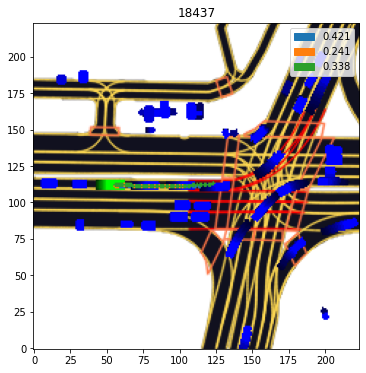

In [ ]:
plot_predicted_trajectory(agent_semantic_dataset, df_sub, [18437], width=6, height=6, n_cols=1)

In [ ]:
i_plots = np.random.randint(len(agent_semantic_dataset), size=9)
# i_plots = (i_plots - i_plots[0] + 18552) % len(agent_semantic_dataset)
i_plots

array([15795,   860, 54886,  6265, 37194, 44131, 60263, 16023, 41090])

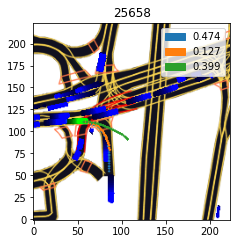

In [ ]:
plot_predicted_trajectory(agent_semantic_dataset, df_sub, 25658)

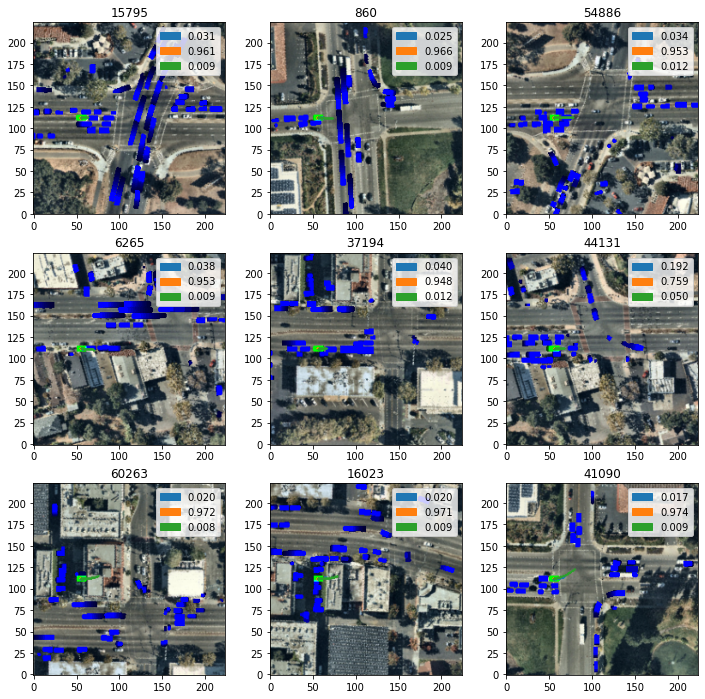

In [ ]:
plot_predicted_trajectory(agent_satellite_dataset, df_sub, i_plots)

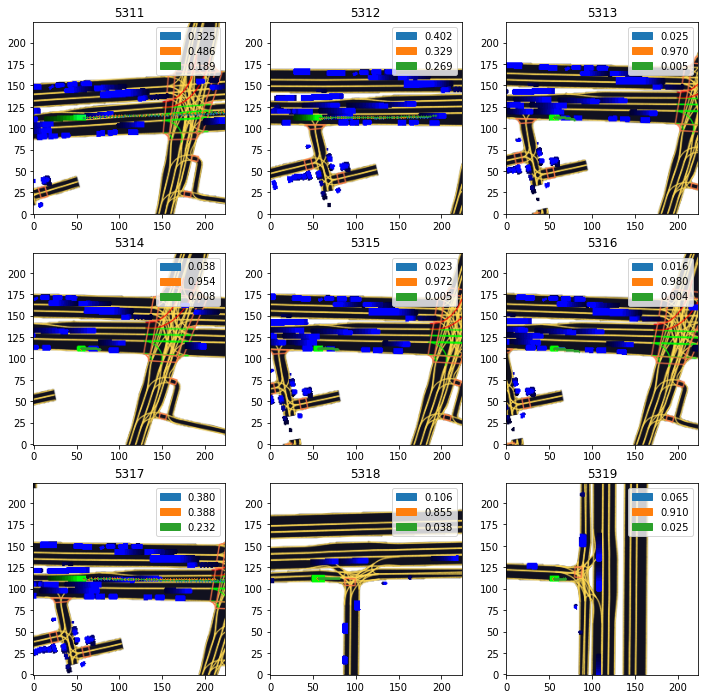

In [ ]:
# note in the test set the each agent only have very few frames.
plot_predicted_trajectory(agent_semantic_dataset, df_sub, list(range(5311, 5311+9)))

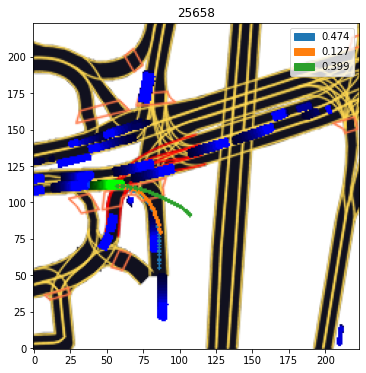

In [ ]:
# weird case
plot_predicted_trajectory(agent_semantic_dataset, df_sub, [25658], width=6, height=6, n_cols=1)

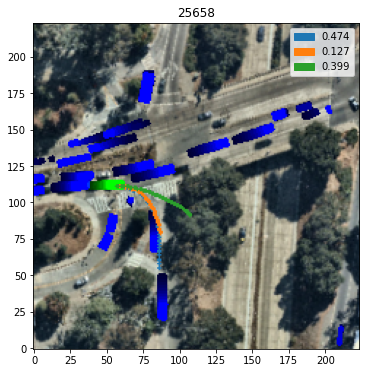

In [ ]:
# weird case
plot_predicted_trajectory(agent_satellite_dataset, df_sub, [25658], width=6, height=6, n_cols=1)

In [ ]:
def animate(images):
    fig = plt.figure()
    ims = [(plt.imshow(im, animated=True, origin='lower'),) for im in images]
    anim = animation.ArtistAnimation(fig, ims, interval=60, blit=True, repeat_delay=1000)
    plt.close()
    return HTML(anim.to_jshtml())

def plot_scene(dataset, scene_id):
    indices = dataset.get_scene_indices(scene_id)
    print('scene', scene_id, ':', indices[0], '-', indices[-1])
    images = [generate_image_trajectory(dataset, i) for i in indices]
    return animate(images)

import bisect
def get_scene_index_from_frame_id(dataset, frame_id):
    return bisect.bisect_right(dataset.cumulative_sizes, frame_id)

In [ ]:
scene_id = get_scene_index_from_frame_id(semantic_dataset, i_plots[0])

In [ ]:
plot_scene(semantic_dataset, scene_id)

scene 157 : 15700 - 15799


In [ ]:
plot_scene(satellite_dataset, scene_id)

scene 157 : 15700 - 15799


In [ ]:
agent_scene_id = get_scene_index_from_frame_id(agent_semantic_dataset, i_plots[4])

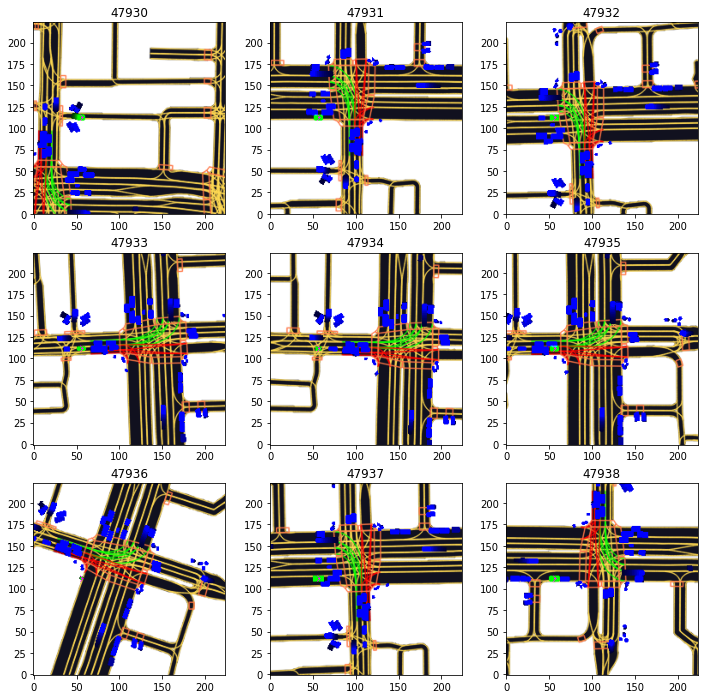

In [ ]:
# see what each agent were doing
plot_trajectory(agent_semantic_dataset, list(range(47930, 47930+9)))

### Let's take a look at our 3 datasets

In [ ]:
train_dt = ChunkedDataset(cfg['data_path']+'/scenes/train.zarr').open(cached=False)
valid_dt = ChunkedDataset(cfg['data_path']+'/scenes/validate.zarr').open(cached=False)
test_dt = ChunkedDataset(cfg['data_path']+'/scenes/test.zarr').open(cached=False)

In [ ]:
pd.DataFrame([
    ['train', len(train_dt.frames), len(train_dt.agents), len(train_dt.scenes), len(train_dt.tl_faces)],
    ['valid', len(valid_dt.frames), len(valid_dt.agents), len(valid_dt.scenes), len(valid_dt.tl_faces)],
    ['test', len(test_dt.frames), len(test_dt.agents), len(test_dt.scenes), len(test_dt.tl_faces)],
], columns=['set', 'frames', 'agents', 'scenes', 'tl_faces'])

,set,frames,agents,scenes,tl_faces
0,train,4039527,320124624,16265,38735988
1,valid,4030296,312617887,16220,29277930
2,test,1131400,88594921,11314,7854144


In [ ]:
def ts_to_dt(ts):
    return datetime.datetime.fromtimestamp(ts // 10**9)

In [ ]:
train_scenes = pd.DataFrame(
    [[f['host'], f['start_time'], f['end_time']] for f in train_dt.scenes],
    columns=['host', 'start', 'end']
)
valid_scenes = pd.DataFrame(
    [[f['host'], f['start_time'], f['end_time']] for f in valid_dt.scenes],
    columns=['host', 'start', 'end']
)
test_scenes = pd.DataFrame(
    [[f['host'], f['start_time'], f['end_time']] for f in test_dt.scenes],
    columns=['host', 'start', 'end']
)
train_scenes['set'] = 'train'
test_scenes['set'] = 'test'
valid_scenes['set'] = 'valid'
scenes = pd.concat([train_scenes, test_scenes, valid_scenes])

In [ ]:
import datetime
scenes['start_time'] = scenes.start.apply(ts_to_dt)
scenes['end_time'] = scenes.end.apply(ts_to_dt)
scenes['duration'] = (scenes.end - scenes.start) / 10**9

In [ ]:
'duration', scenes.duration.unique()
pd.concat([
    scenes.groupby(['set', 'host']).start_time.min(),
    scenes.groupby(['set', 'host']).end_time.max()
], axis=1)

start_time            end_time
set   host                                             
test  host-a118 2020-01-09 21:39:57 2020-03-09 18:45:58
      host-a119 2020-01-09 16:49:34 2020-03-10 18:07:01
train host-a013 2019-11-01 21:28:04 2019-11-01 21:52:06
      host-a101 2019-10-14 20:55:39 2020-03-13 22:41:54
      host-a102 2019-11-21 21:37:42 2020-02-18 23:44:47
      host-a103 2019-11-08 21:13:04 2020-01-28 17:31:31
valid host-a116 2019-12-13 16:36:10 2020-03-05 22:13:23
      host-a117 2019-11-21 19:26:29 2020-03-13 23:01:31
      host-a118 2019-12-13 20:44:15 2020-01-09 21:22:07

In [ ]:
#!pip install plotly-express
import plotly.express as px 
import orca 
# Had to follow https://stackoverflow.com/questions/53710227/locate-lib-orca-with-python#:~:text=Right%20click%20on%20the%20desktop,%5Cio%20)%20open%20_orca.py
plotly.io.orca.config.executable = './bin/orca-1.2.1-x86_64.AppImage'
plotly.io.orca.config.save()


In [ ]:
train_times = pd.DataFrame({'t': [ts_to_dt(f['timestamp']) for f in train_dt.frames]})
test_times = pd.DataFrame({'t': [ts_to_dt(f['timestamp']) for f in test_dt.frames]})
valid_times = pd.DataFrame({'t': [ts_to_dt(f['timestamp']) for f in valid_dt.frames]})


train_times['set'] = 'train'
test_times['set'] = 'test'
valid_times['set'] = 'valid'
times = pd.concat([train_times, test_times, valid_times])

times['cnt'] = 1
times['h'] = times.t.dt.round("H")
times['day'] = times.t.dt.round("D")


times

df = times.groupby(['set', 'day']).sum().reset_index()

In [ ]:
fig = px.bar(df, x='day', y='cnt', color='set', title='Train-Valid-Test split')
fig.write_image('train-test-split.png')
fig.show()

# Frame locations

In [ ]:
train_locs = pd.DataFrame(
    [f['ego_translation'] for f in train_dt.frames], columns=['x', 'y', 'z'])
test_locs = pd.DataFrame(
    [f['ego_translation'] for f in test_dt.frames], columns=['x', 'y', 'z'])
valid_locs = pd.DataFrame(
    [f['ego_translation'] for f in valid_dt.frames], columns=['x', 'y', 'z'])

train_locs = train_locs.round()

train_locs['set'] = 'train'
test_locs['set'] = 'test'
valid_locs['set'] = 'valid'
locs = pd.concat([train_locs, test_locs, valid_locs])
locs = locs.round()
locs['cnt'] = 1

df = locs.groupby(['set', 'x', 'y']).sum().reset_index()

In [ ]:
f1 = px.scatter(df[df.set == 'train'], x='x', y='y', size='cnt', title='Train - Locations', opacity=0.5)
f1.update_traces(marker=dict(color='red', line_width=0))

In [ ]:
f2 = px.scatter(df[df.set == 'test'], x='x', y='y', size='cnt', title='Test - Locations', opacity=0.5)
f2.update_traces(marker=dict(color='blue', line_width=0))

In [ ]:
f3 = px.scatter(df[df.set == 'valid'], x='x', y='y', size='cnt', title='Valid - Locations', opacity=0.5)
f3.update_traces(marker=dict(color='green', line_width=0))

In [ ]:
display(df_sub)

conf_0    conf_1    conf_2  coord_x00  \
timestamp           track_id                                            
1578606007801600134 2         0.502480  0.205125  0.292395   -0.11273   
1578606032802467516 4         0.380652  0.358710  0.260638   -0.63477   
                    5         0.542430  0.093180  0.364390    0.12414   
                    81        0.213895  0.720917  0.065187   -0.25885   
                    130       0.035118  0.953250  0.011632    0.01142   
...                                ...       ...       ...        ...   
1583863581802681726 253       0.394328  0.332868  0.272804    0.41381   
1583863606802928836 1         0.393627  0.380866  0.225508   -0.12056   
                    6         0.449566  0.303890  0.246544   -0.11545   
                    213       0.349951  0.426899  0.223151   -0.09739   
                    250       0.026675  0.961641  0.011684    0.00730   

                              coord_y00  coord_x01  coord_y01  coord_x02  \
timestamp           track_id                                               
1578606007801600134 2           0.22052   -0.22827    0.47644   -0.33984   
1578606032802467516 4          -0.97205   -1.21299   -1.90659   -1.71423   
                    5           0.20155    0.25162    0.38692    0.32335   
                    81         -0.41525   -0.50425   -0.77621   -0.67320   
                    130        -0.00426    0.02232   -0.01539    0.04585   
...                                 ...        ...        ...        ...   
1583863581802681726 253         0.56903    0.86008    1.13860    1.22542   
1583863606802928836 1          -0.66451   -0.23772   -1.31072   -0.35416   
                    6          -0.24222   -0.24895   -0.51530   -0.34641   
                    213         0.09291   -0.20722    0.21068   -0.30974   
                    250         0.00231    0.01193    0.02457    0.00738   

                              coord_y02  coord_x03  ...  coord_x245  \
timestamp           track_id                        ...               
1578606007801600134 2           0.70938   -0.43328  ...    -3.77350   
1578606032802467516 4          -2.77318   -2.30782  ...   -26.60185   
                    5           0.48188    0.40778  ...    10.76700   
                    81         -1.08616   -0.87364  ...   -14.57502   
                    130        -0.01270    0.07871  ...     7.54188   
...                                 ...        ...  ...         ...   
1583863581802681726 253         1.64566    1.65775  ...    25.76309   
1583863606802928836 1          -1.84177   -0.50479  ...    -8.32895   
                    6          -0.76212   -0.47210  ...    -9.05620   
                    213         0.29671   -0.37174  ...    -1.60544   
                    250         0.00291    0.00285  ...     4.25917   

                              coord_y245  coord_x246  coord_y246  coord_x247  \
timestamp           track_id                                                   
1578606007801600134 2            9.78204    -3.82382     9.98727    -3.82410   
1578606032802467516 4          -52.09507   -27.16204   -53.32994   -27.69998   
                    5           16.50119    11.21318    17.16005    11.64454   
                    81         -20.05598   -15.00511   -20.66341   -15.39089   
                    130         -4.43858     7.81336    -4.62239     8.11577   
...                                  ...         ...         ...         ...   
1583863581802681726 253         26.27295    26.44862    26.82519    27.10458   
1583863606802928836 1          -24.28993    -8.52438   -24.70271    -8.63008   
                    6          -18.69624    -9.27567   -19.12498    -9.51517   
                    213         18.46396    -1.43845    19.15160    -1.23396   
                    250         11.79742     4.41907    12.30276     4.55520   

                              coord_y247  coord_x248  coord_y248  coord_x249  \
timestamp           track_id                    

In [ ]:
# set env variable for data
DIR_INPUT = cfg["data_path"]
os.environ["L5KIT_DATA_FOLDER"] = DIR_INPUT
dm = LocalDataManager(None)

In [ ]:
import shutil
from pathlib import Path
# ===== GENERATE AND LOAD CHOPPED DATASET
num_frames_to_chop = 100
eval_cfg = cfg["val_data_loader"]

eval_cfg["key"] = "scenes/sample.zarr"
MIN_FUTURE_STEPS = cfg['train_params']['max_num_steps']
print(MIN_FUTURE_STEPS)
# As the /kaggle/input directory is not writeable as required to chop,
# copy the sample set to /tmp
!rm -rf /tmp/lyft
eval_dir = shutil.copytree(dm.require(eval_cfg["key"]), '/tmp/lyft/sample.zarr')

eval_base_path = create_chopped_dataset(eval_dir, cfg["raster_params"]["filter_agents_threshold"], num_frames_to_chop, cfg["model_params"]["future_num_frames"], MIN_FUTURE_STEPS)
#!ls {eval_base_path}

In [ ]:
eval_zarr_path = str(Path(eval_base_path) / Path(dm.require(eval_cfg["key"])).name)
eval_mask_path = str(Path(eval_base_path) / "mask.npz")
eval_gt_path = str(Path(eval_base_path) / "gt.csv")

eval_zarr = ChunkedDataset(eval_zarr_path).open()
eval_mask = np.load(eval_mask_path)["arr_0"]
# ===== INIT DATASET AND LOAD MASK
eval_dataset = AgentDataset(cfg, eval_zarr, rasterizer, agents_mask=eval_mask)
print(eval_dataset)